# limited features LWTNN model

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from pathlib import Path

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import sys
sys.path.append("../../")
DATA_PATH = Path('../../../data/')
MODEL_PATH = Path('../../../models/keras2lwtnn')

In [4]:
import cufflinks as cf
import plotly.offline as py
py.init_notebook_mode()
cf.go_offline()
import plotly.graph_objs as go

## Data

In [9]:
k = 1
sampled_data = pd.read_pickle(DATA_PATH /'train_data.pkl').sample(frac=k, random_state=137)
# sample size

In [10]:


# split on train and test
from sklearn.model_selection import train_test_split
from data_pipeline import dropFalseMCParticles

unused_features = [
    'index', 'seed_nbIT', 'seed_nLayers', 'seed_mva_value', 'seed_nLHCbIDs',
    'is_downstream_reconstructible_not_electron', 'is_true_seed',
    'has_MCParticle_not_electron'
]
data = sampled_data.drop(unused_features, axis=1)
data = dropFalseMCParticles().fit_transform(data)
data = data.astype(np.float32)

data.info()

train_set, test_set = train_test_split(data, test_size=0.3, random_state=42)
label_names = [
    'is_downstream_reconstructible'
]

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1754766 entries, 1042314 to 3481
Data columns (total 8 columns):
is_downstream_reconstructible    float32
seed_chi2PerDoF                  float32
seed_p                           float32
seed_pt                          float32
seed_x                           float32
seed_y                           float32
seed_tx                          float32
seed_ty                          float32
dtypes: float32(8)
memory usage: 66.9 MB


In [11]:
x_train = train_set.drop(label_names, axis=1)
y_train = train_set[label_names].copy().astype(np.int32)

x_test = test_set.drop(label_names, axis=1)
y_test = test_set[label_names].copy().astype(np.int32)

In [7]:
from data_pipeline import data_pipeline_3 as data_pipeline
pipeline = data_pipeline()
x_train = pipeline.fit_transform(x_train)
x_test = pipeline.transform(x_test)

In [8]:
x_test.head()

,seed_chi2PerDoF,seed_p,seed_pt,seed_x,seed_y,seed_tx,seed_ty,seed_pr,seed_r
980894,0.353879,1.480723,1.238218,0.379702,0.401177,0.196788,0.486859,-0.932890,-0.711794
2242157,-0.270153,-0.875049,-0.866677,1.035978,3.212416,-0.589995,2.869197,0.146737,2.069929
266037,-0.942391,1.083935,0.639295,0.394865,0.156106,0.249830,0.156504,-0.889209,-0.800772
946410,-0.823761,0.881096,0.290135,-0.336539,0.101885,-0.232108,0.115508,-0.873311,-0.878368
2006,0.601612,-0.478356,0.055681,-0.961611,0.609134,-0.871131,0.914123,0.203072,0.100653


In [8]:
x_train.sample(frac=0.05).iplot(kind='hist', bins=50)

In [9]:
# x_test.sample(frac=0.05).iplot(kind='hist', bins=50)

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f4820037e80>]], dtype=object)

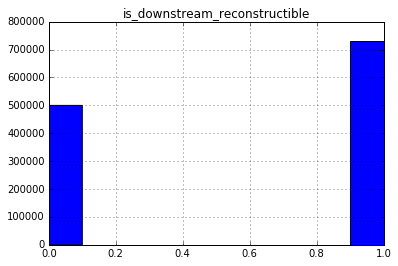

In [10]:
y_train.hist()

In [11]:
# y_test.hist()

In [12]:
from sklearn.utils import class_weight

class_weight = class_weight.compute_class_weight('balanced', np.unique(y_train['is_downstream_reconstructible']), y_train['is_downstream_reconstructible'])

In [13]:
from keras.callbacks import TensorBoard
from models import KerasDNN
from models import LookupClassifier
import time

date_created = time.ctime()

DNNclf = KerasDNN(
    (x_train.shape[1],),
    (2,),
    neurons=100,
    layers=3,
#     dropout=0.05,
    loss_metric='sparse_categorical_crossentropy',
    metrics=['accuracy'],
    last_layer_act='softmax'
)



Using TensorFlow backend.


In [14]:
DNNclf.fit(
    x_train.values, y_train.values,
    epochs=20,
    validation_data=(x_test.values, y_test.values)

)

Train on 1228336 samples, validate on 526430 samples
Epoch 1/20
1228336/1228336 [==============================] - 147s - loss: 0.3767 - acc: 0.8422 - val_loss: 0.3479 - val_acc: 0.8632
Epoch 2/20
1228336/1228336 [==============================] - 147s - loss: 0.3471 - acc: 0.8594 - val_loss: 0.3402 - val_acc: 0.8669
Epoch 3/20
1228336/1228336 [==============================] - 147s - loss: 0.3396 - acc: 0.8630 - val_loss: 0.3333 - val_acc: 0.8702
Epoch 4/20
1228336/1228336 [==============================] - 148s - loss: 0.3354 - acc: 0.8651 - val_loss: 0.3200 - val_acc: 0.8748
Epoch 5/20
1228336/1228336 [==============================] - 147s - loss: 0.3323 - acc: 0.8671 - val_loss: 0.3264 - val_acc: 0.8732
Epoch 6/20
1228336/1228336 [==============================] - 148s - loss: 0.3305 - acc: 0.8684 - val_loss: 0.3222 - val_acc: 0.8727
Epoch 7/20
1228336/1228336 [==============================] - 151s - loss: 0.3279 - acc: 0.8693 - val_loss: 0.3335 - val_acc: 0.8687
Epoch 8/20
12283

KeyboardInterrupt: 

In [15]:
DNNclf.model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 9)                 0         
_________________________________________________________________
dense_1 (Dense)              (None, 100)               1000      
_________________________________________________________________
batch_normalization_1 (Batch (None, 100)               400       
_________________________________________________________________
dense_2 (Dense)              (None, 100)               10100     
_________________________________________________________________
batch_normalization_2 (Batch (None, 100)               400       
_________________________________________________________________
dense_3 (Dense)              (None, 100)               10100     
_________________________________________________________________
batch_normalization_3 (Batch (None, 100)               400       
__________

### Quick evaluation

In [17]:
from sklearn.metrics import accuracy_score

In [18]:
%time accuracy_score(y_test.values, DNNclf.predict(x_test.values))

CPU times: user 28 s, sys: 1.18 s, total: 29.2 s
Wall time: 13.3 s


0.87124024086773166

In [19]:
from sklearn.metrics import roc_auc_score

In [20]:
roc_auc_score(y_test.values, DNNclf.predict_proba(x_test.values)[:,1] )

0.92792684655390723

### PIpeline info

In [21]:
pipeline.named_steps

{'chi2PerDoF': chi2PerDoFScaler(),
 'p': pScale(),
 'pseudo rapidity': addPR(),
 'pt': ptScale(),
 'radius': addR(),
 'tx': txScale(),
 'ty': tyScale(),
 'x': xScale(),
 'y': yScale()}

In [22]:
for name, step in pipeline.named_steps.items():
    print(step)
    try:
        print(step.scaler.scale_)
        print('std: ', step.scaler.scale_)
        print('mean: ', step.scaler.mean_)
    except Exception as e:
            pass

yScale()
[ 504.799883]
std:  [ 504.799883]
mean:  [ 1.0987292]
tyScale()
[ 0.06486862]
std:  [ 0.06486862]
mean:  [ 0.00013073]
ptScale()
[ 0.20677143]
std:  [ 0.20677143]
mean:  [ 3.08250979]
addPR()
[ 0.17856324]
std:  [ 0.17856324]
mean:  [ 0.22914613]
xScale()
[ 718.45885408]
std:  [ 718.45885408]
mean:  [-3.58761813]
txScale()
[ 0.29576847]
std:  [ 0.29576847]
mean:  [-0.00422249]
chi2PerDoFScaler()
[ 0.37649142]
std:  [ 0.37649142]
mean:  [ 1.23350879]
pScale()
[ 0.44031953]
std:  [ 0.44031953]
mean:  [ 3.89077256]
addR()
[ 519.91120035]
std:  [ 519.91120035]
mean:  [ 707.61042581]


### Saving model

In [23]:
model_arch = DNNclf.model.to_json()

In [24]:
a = (MODEL_PATH / date_created)

In [26]:
import os

In [27]:
os.mkdir((MODEL_PATH / date_created).as_posix())

In [28]:
with (MODEL_PATH / date_created / 'architecture.json').open('w') as arch_file:
    arch_file.write(model_arch)

In [29]:
DNNclf.model.save_weights(MODEL_PATH / date_created / 'weights.h5')

In [34]:
x_test[:5]

,seed_chi2PerDoF,seed_p,seed_pt,seed_x,seed_y,seed_tx,seed_ty,seed_pr,seed_r
980894,0.353879,1.480723,1.238218,0.379702,0.401177,0.196788,0.486859,-0.932890,-0.711794
2242157,-0.270153,-0.875049,-0.866677,1.035978,3.212416,-0.589995,2.869197,0.146737,2.069929
266037,-0.942391,1.083935,0.639295,0.394865,0.156106,0.249830,0.156504,-0.889209,-0.800772
946410,-0.823761,0.881096,0.290135,-0.336539,0.101885,-0.232108,0.115508,-0.873311,-0.878368
2006,0.601612,-0.478356,0.055681,-0.961611,0.609134,-0.871131,0.914123,0.203072,0.100653


In [35]:
y_test[:5]

,is_downstream_reconstructible
980894,1
2242157,1
266037,1
946410,0
2006,0


In [36]:
DNNclf.predict(x_test.values[:5])

array([1, 1, 1, 0, 0])

In [37]:
test_predictions = DNNclf.predict(x_test.values)

In [13]:
x_test.head()

,seed_chi2PerDoF,seed_p,seed_pt,seed_x,seed_y,seed_tx,seed_ty
980894,1.867982,34895.058594,2180.408691,269.212524,203.612854,0.053981,0.031713
2242157,1.280968,3202.369873,800.397583,740.719604,1622.726074,-0.178724,0.186252
266037,0.772125,23337.273438,1639.448364,280.106812,79.900902,0.069669,0.010283
946410,0.852612,18999.234375,1388.357422,-245.376968,52.530251,-0.072873,0.007624
2006,2.131630,4787.878418,1241.717896,-694.465515,308.589752,-0.261876,0.059429
